# Notebook to clean 50 samplesdata

## Notebook description

This notebook is used to clean all 50 data sets which will be used in this project.

The cleaning will start by cropping all data sets to the same length. Afterwards follows a down-sampling on the data.

## Imports

In [61]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import datetime
import pandas as pd
import numpy as np
import seaborn as sns
import math
from functools import reduce
sns.set()
%matplotlib inline
import os

### GLOBALS

In [62]:
PATH_RAW = 'data/raw/samples/'
PATH_CLEAN = 'data/cleaned/samples50/'
IMAGES_DIR = 'images/cleaned/'
THRESHOLD = 715


In [6]:
#%ll data/raw/samples

### Verify number of files

In [63]:
counter = 0
for filename in os.listdir(PATH_RAW):
    if filename.endswith(".csv"):
        counter += 1
print(f"There are {counter} csv files in {PATH_RAW}")

There are 47 csv files in data/raw/samples/


In [64]:
data_frames = []
for filename in os.listdir(PATH_RAW):
    tmp_df = pd.read_csv(PATH_RAW + filename)
    data_frames.append(tmp_df)

In [28]:
#for _df in data_frames:
#    print(_df.shape)
#data_frames[17]

# Data Cleaning

Combine the date, hour, minute and second fields to a date-time. 
This may take a while!

In [65]:
def create_time_stamp(row):
    # '2020-04-06T09:03:51+0000'
    seconds = int(row['second'])
    minutes = int(row['minute'])
    hours = int(row['hour'])
    date = row['date']  # 2020-09-09
    
    ts_str = f"{date}T{hours}:{minutes}:{seconds}+0000"
    ts_obj = datetime.datetime.strptime(ts_str, '%Y-%m-%dT%H:%M:%S%z')
    return ts_obj

# Create Timestamps
for _df in data_frames:
    _df['timestamp'] = _df.apply(lambda row: create_time_stamp(row), axis=1)

In [66]:
data_frames[17].timestamp.duplicated().sum()

3594

## Deal with dublicated values

Print duplicates

In [67]:
for i, _df in enumerate(data_frames):
    print(f"Number of duplicated timestamps in #{i+1}: {_df.timestamp.duplicated().sum()}")


Number of duplicated timestamps in #1: 5
Number of duplicated timestamps in #2: 13
Number of duplicated timestamps in #3: 0
Number of duplicated timestamps in #4: 120
Number of duplicated timestamps in #5: 0
Number of duplicated timestamps in #6: 0
Number of duplicated timestamps in #7: 0
Number of duplicated timestamps in #8: 7
Number of duplicated timestamps in #9: 0
Number of duplicated timestamps in #10: 0
Number of duplicated timestamps in #11: 1
Number of duplicated timestamps in #12: 118
Number of duplicated timestamps in #13: 2
Number of duplicated timestamps in #14: 0
Number of duplicated timestamps in #15: 244
Number of duplicated timestamps in #16: 118
Number of duplicated timestamps in #17: 120
Number of duplicated timestamps in #18: 3594
Number of duplicated timestamps in #19: 59
Number of duplicated timestamps in #20: 0
Number of duplicated timestamps in #21: 0
Number of duplicated timestamps in #22: 0
Number of duplicated timestamps in #23: 0
Number of duplicated timesta

So far, most DFs look quite ok. However there are 3594 duplicated timestamps in DF-18. This is due to the time change (25.10.2020). Unfortunately there was no UTC indicator saved beforehand. Therefore we are not capable of distiguish the duplicated timestamps between 02:00 and 03:00.
-> Drop the whole DF for now.

In [68]:
_ = data_frames.pop(17)

Drop duplicates, but keep first value

In [69]:
for _df in data_frames:
    _df.drop_duplicates(subset=["timestamp"], keep='first', inplace=True)

Ensure there are no duplicates anymore

In [70]:
for i, _df in enumerate(data_frames):
    print(f"Number of duplicated timestamps in #{i+1}: {_df.timestamp.duplicated().sum()}")

Number of duplicated timestamps in #1: 0
Number of duplicated timestamps in #2: 0
Number of duplicated timestamps in #3: 0
Number of duplicated timestamps in #4: 0
Number of duplicated timestamps in #5: 0
Number of duplicated timestamps in #6: 0
Number of duplicated timestamps in #7: 0
Number of duplicated timestamps in #8: 0
Number of duplicated timestamps in #9: 0
Number of duplicated timestamps in #10: 0
Number of duplicated timestamps in #11: 0
Number of duplicated timestamps in #12: 0
Number of duplicated timestamps in #13: 0
Number of duplicated timestamps in #14: 0
Number of duplicated timestamps in #15: 0
Number of duplicated timestamps in #16: 0
Number of duplicated timestamps in #17: 0
Number of duplicated timestamps in #18: 0
Number of duplicated timestamps in #19: 0
Number of duplicated timestamps in #20: 0
Number of duplicated timestamps in #21: 0
Number of duplicated timestamps in #22: 0
Number of duplicated timestamps in #23: 0
Number of duplicated timestamps in #24: 0
N

## Change index

In [71]:
for _df in data_frames:
    try:
        _df.set_index('timestamp', inplace=True)
    except KeyError:
        pass

In [72]:
for _df in data_frames:
    _df.sort_index(inplace=True)

# Replace missing values

First of all we want to make sure, that all time series start at the same time and have a value for every second.

## Crop to the same length

The used time series are recorded from 8:00 PM to 10:00 AM.
The sampling granularity is one second. However due to the sensors behaviour, some data points are missing every 30s.
Due to the fine granularity this is negligible.
Most often the first few 1000 measures of these time series are 0 (the bed is not yet occupied). Therefore we will crop them at the beginning and end to have the same start and endpoint.

If data would be sent every second wihout missing data, each time series would be $14\cdot3600 = 50400$ rows long. However the length is usually around 48000.

In [73]:
start_time_dates = []
end_time_dates = []
for _df in data_frames:

    ts_start = _df.index[0]
    ts_end = _df.index[-1]
    
    start_time_dates.append(ts_start)
    end_time_dates.append(ts_end)

In [74]:
# Remove date, only keep time

start_times = list(map(lambda x: x.time(), start_time_dates))
end_times = list(map(lambda x: x.time(), end_time_dates))

In [75]:
same_start_time = None
same_end_time = None

# Take the biggest index as start
same_start_time = max(start_times)

# Take the smallest index as end
same_end_time = min(end_times)
    
print(f"The dataframes need to be cropped from {same_start_time}PM to {same_end_time}AM")

The dataframes need to be cropped from 20:00:30PM to 09:52:34AM


In [76]:
str(same_start_time)

'20:00:30'

In [77]:
same_start_length_dfs = []
for _df in data_frames:
    
    start_date = _df.iloc[0].date  # E.g 2020-10-02
    end_date = _df.iloc[-1].date  # E.g 2020-10-03
    
    """
    start_day = int(_df.loc[0].day)
    end_day = int(_df.loc[-1].day)
    
    start_month = int(_df.loc[0].month)
    end_month = int(_df.loc[-1].month)
    
    start_year = int(_df.loc[0].year)
    end_year = int(_df.loc[-1].year)
    """
     
    start_index_str = f"{start_date}T{same_start_time}+0000"
    start_index = datetime.datetime.strptime(start_index_str, '%Y-%m-%dT%H:%M:%S%z')
    
    end_index_str = f"{end_date}T{same_end_time}+0000"
    end_index = datetime.datetime.strptime(end_index_str, '%Y-%m-%dT%H:%M:%S%z')
        
    new_df = _df[start_index:end_index]
    same_start_length_dfs.append(new_df)


## Fill in data for every second

In [78]:
same_length_dfs = []
for _df in same_start_length_dfs:
    tmp_df = _df.asfreq('s', method='ffill')
    same_length_dfs.append(tmp_df)

## Replace wrong zero-values

This cell has to compute around $50 * 48'000 = 2'400'000$ rows. Therefore it takes several minutes.

In [79]:
LAST_VAL = 0

def custom_ffill(row, col_name):
    global LAST_VAL
    if row['measured_signal_strength'] > THRESHOLD and row[col_name] == 0:
        row[f'{col_name}_ff'] = LAST_VAL
        LAST_VAL = row[f'{col_name}_ff']
    else:
        LAST_VAL = row[col_name]
    return row

c_fill_dfs = []


for _df in same_length_dfs:
    for attribute in ['heart_rate', 'respiration_rate']:
        LAST_VAL = 0  # Reset LAST_VAL
        
        _df[f'{attribute}_ff'] = _df[attribute]
        tmp_df = _df.apply(lambda row: custom_ffill(row, attribute), axis='columns')
    c_fill_dfs.append(tmp_df)

print(len(c_fill_dfs))

46


Only keep the following values for now:

In [80]:
dfs = []
for _df in c_fill_dfs:
    tmp_df = _df[['heart_rate_ff', 'respiration_rate_ff', 'measured_signal_strength', 'patient']]
    dfs.append(tmp_df)

In [122]:
#dfs[0]

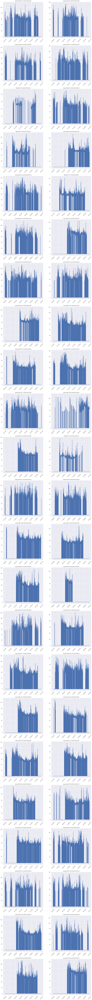

In [35]:
def display_data(data_frames, feature='heart_rate_ff', save=False, file_name=""):
    nbr_dfs = len(data_frames)
    
    #fig, axs = plt.subplots(10, 5, figsize=(18,9 * nbr_dfs/5))
    fig, axs = plt.subplots(23, 2, figsize=(18,9 * nbr_dfs/2))

    xs = [_df.index for _df in data_frames]    
    ys = [_df[feature] for _df in data_frames]
    titles = [f"{_df.iloc[0]['patient']} {_df.index[0]}"
              for _df in data_frames]
    
    for column in range(2):
        for row in range(23):
            i = row*2 + column
            axs[row][column].plot(xs[i], ys[i])
            axs[row][column].xaxis.set_tick_params(rotation=45)
            axs[row][column].set_title(titles[i])
            
    if save:
        if not file_name:
            file_name = f'all_cleaned_samples_{feature}.png'
        fig.savefig(IMAGES_DIR + file_name)

    plt.show()

display_data(dfs, 'heart_rate_ff', True)


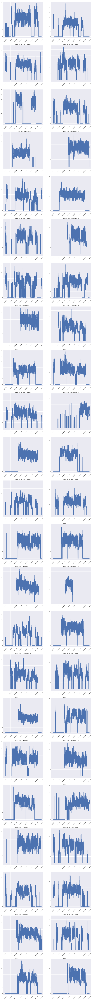

In [36]:
display_data(dfs, 'respiration_rate_ff', True)

## Downsampling

The downsampling shall produce different granularities using resample approaches.

* 1 Hour
* 30 Minutes
* 5 Minutes
* 1 Minute


In [81]:
dfs[0][['heart_rate_ff', 'respiration_rate_ff', 'measured_signal_strength', 'patient']].resample('60Min').mean()

,heart_rate_ff,respiration_rate_ff,measured_signal_strength
timestamp,,,
2020-10-14 20:00:00+00:00,2.302521,0.941737,663.849580
2020-10-14 21:00:00+00:00,1.961944,0.402778,542.005000
2020-10-14 22:00:00+00:00,36.632222,7.954444,1210.320833
2020-10-14 23:00:00+00:00,18.368889,3.744444,812.383889
2020-10-15 00:00:00+00:00,65.049444,14.731944,1636.631667
2020-10-15 01:00:00+00:00,61.674167,14.470278,1737.572778
2020-10-15 02:00:00+00:00,55.741389,13.112778,1575.345000
2020-10-15 03:00:00+00:00,54.245000,12.398889,1659.923889
2020-10-15 04:00:00+00:00,55.600000,12.931667,1896.620000


### 1 Hour granularity

In [82]:
dfs_1h = []
for _df in dfs:
    patient = _df.iloc[0].patient
    df_1h = _df[['heart_rate_ff', 'respiration_rate_ff', 'measured_signal_strength']].resample('60Min').mean()
    df_1h.columns = ['heart_rate', 'respiration_rate', 'mss']
    #df_1h['patient'] = [patient for _ in range(df_1h.shape[0])]
    df_1h['patient'] = df_1h.apply(lambda _: patient, axis=1)
    dfs_1h.append(df_1h)


In [83]:
dfs_1h[0].head()

,heart_rate,respiration_rate,mss,patient
timestamp,,,,
2020-10-14 20:00:00+00:00,2.302521,0.941737,663.849580,eeeee
2020-10-14 21:00:00+00:00,1.961944,0.402778,542.005000,eeeee
2020-10-14 22:00:00+00:00,36.632222,7.954444,1210.320833,eeeee
2020-10-14 23:00:00+00:00,18.368889,3.744444,812.383889,eeeee
2020-10-15 00:00:00+00:00,65.049444,14.731944,1636.631667,eeeee


In [84]:
len(dfs)

46

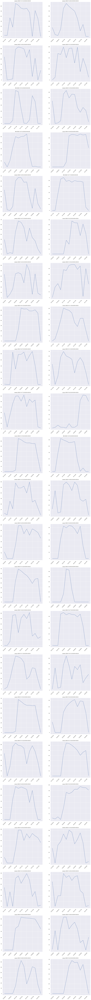

In [85]:
display_data(dfs_1h, 'heart_rate', True, 'all_cleaned_samples_heart_rate_1hour.png')


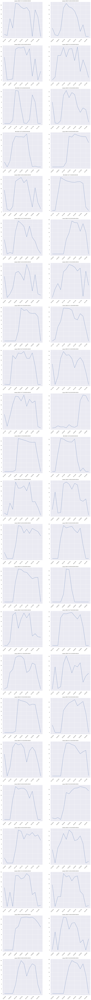

In [86]:
display_data(dfs_1h, 'respiration_rate', True, 'all_cleaned_samples_respiration_rate_1hour.png')

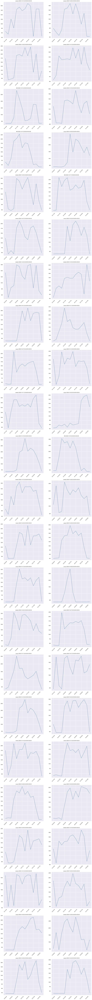

In [103]:
display_data(dfs_1h, 'mss', True, 'all_cleaned_samples_mss_1hour.png')

In [87]:
patient_counter = {'ddddd': 0,
                   'eeeee': 0,
                   'ttttt': 0,
                   'vvvvv': 0,
                   'xxxxx': 0,
                   'yyyyy': 0}

for _df in dfs_1h:
    patient = _df.iloc[0].patient
    #print(patient)
    patient_counter[patient] += 1
    nbr = patient_counter[patient]
    
    _df.to_csv(PATH_CLEAN + 'one_hour/' + f'{patient}_{nbr}.csv')

print(patient_counter)

{'ddddd': 0, 'eeeee': 18, 'ttttt': 4, 'vvvvv': 0, 'xxxxx': 8, 'yyyyy': 16}


### 30 min granularity

In [88]:
dfs_30m = []
for _df in dfs:
    patient = _df.iloc[0].patient
    df_30m = _df[['heart_rate_ff', 'respiration_rate_ff', 'measured_signal_strength']].resample('30Min').mean()
    df_30m.columns = ['heart_rate', 'respiration_rate', 'mss']
    #df_1h['patient'] = [patient for _ in range(df_1h.shape[0])]
    df_30m['patient'] = df_30m.apply(lambda _: patient, axis=1)
    dfs_30m.append(df_30m)


In [89]:
dfs_30m[0]

,heart_rate,respiration_rate,mss,patient
timestamp,,,,
2020-10-14 20:00:00+00:00,2.885311,1.129944,716.779096,eeeee
2020-10-14 20:30:00+00:00,1.729444,0.756667,611.802222,eeeee
2020-10-14 21:00:00+00:00,0.111111,0.066111,527.958333,eeeee
2020-10-14 21:30:00+00:00,3.812778,0.739444,556.051667,eeeee
2020-10-14 22:00:00+00:00,50.372778,10.569444,1324.806667,eeeee
2020-10-14 22:30:00+00:00,22.891667,5.339444,1095.835000,eeeee
2020-10-14 23:00:00+00:00,1.492778,0.278333,495.783889,eeeee
2020-10-14 23:30:00+00:00,35.245000,7.210556,1128.983889,eeeee
2020-10-15 00:00:00+00:00,63.797222,13.999444,1768.782778,eeeee


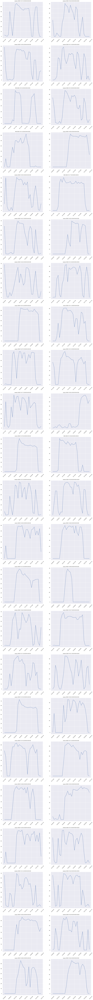

In [90]:
display_data(dfs_30m, 'heart_rate', True, 'all_cleaned_samples_heart_rate_30min.png')

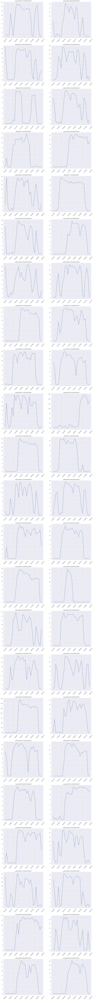

In [91]:
display_data(dfs_30m, 'respiration_rate', True, 'all_cleaned_samples_respiration_rate_30min.png')

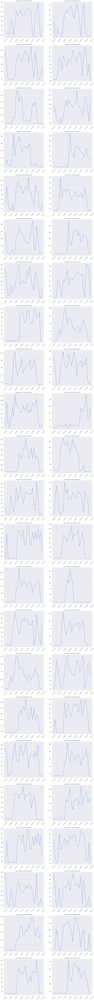

In [104]:
display_data(dfs_30m, 'mss', True, 'all_cleaned_samples_mss_30min.png')

In [92]:
patient_counter = {'ddddd': 0,
                   'eeeee': 0,
                   'ttttt': 0,
                   'vvvvv': 0,
                   'xxxxx': 0,
                   'yyyyy': 0}

for _df in dfs_30m:
    patient = _df.iloc[0].patient
    #print(patient)
    patient_counter[patient] += 1
    nbr = patient_counter[patient]
    
    _df.to_csv(PATH_CLEAN + 'thirty_min/' + f'{patient}_{nbr}.csv')

print(patient_counter)

{'ddddd': 0, 'eeeee': 18, 'ttttt': 4, 'vvvvv': 0, 'xxxxx': 8, 'yyyyy': 16}


### 5 min granularity

In [93]:
dfs_5m = []
for _df in dfs:
    patient = _df.iloc[0].patient
    df_5m = _df[['heart_rate_ff', 'respiration_rate_ff', 'measured_signal_strength']].resample('5Min').mean()
    df_5m.columns = ['heart_rate', 'respiration_rate', 'mss']
    df_5m['patient'] = df_5m.apply(lambda _: patient, axis=1)
    dfs_5m.append(df_5m)


In [94]:
dfs_5m[0]

,heart_rate,respiration_rate,mss,patient
timestamp,,,,
2020-10-14 20:00:00+00:00,3.644444,1.400000,721.525926,eeeee
2020-10-14 20:05:00+00:00,8.110000,2.306667,740.336667,eeeee
2020-10-14 20:10:00+00:00,1.860000,0.966667,717.873333,eeeee
2020-10-14 20:15:00+00:00,1.356667,1.066667,716.036667,eeeee
2020-10-14 20:20:00+00:00,0.000000,0.000000,615.020000,eeeee
...,...,...,...,...
2020-10-15 09:30:00+00:00,0.000000,0.000000,438.840000,eeeee
2020-10-15 09:35:00+00:00,0.000000,0.000000,464.086667,eeeee
2020-10-15 09:40:00+00:00,0.000000,0.000000,507.013333,eeeee


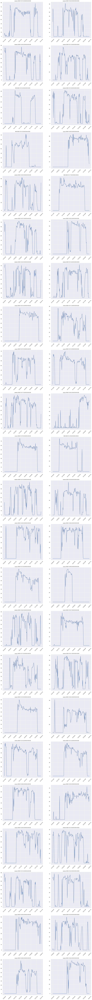

In [95]:
display_data(dfs_5m, 'heart_rate', True, 'all_cleaned_samples_heart_rate_5min.png')

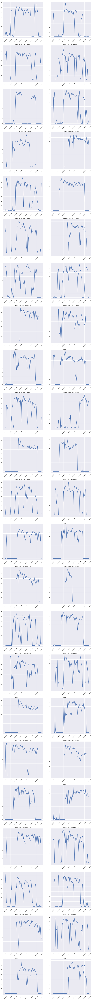

In [96]:
display_data(dfs_5m, 'respiration_rate', True, 'all_cleaned_samples_respiration_rate_5min.png')

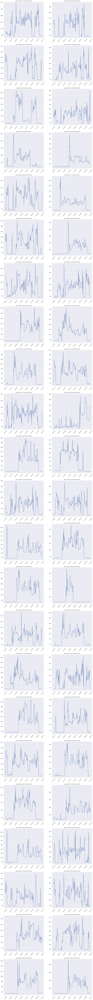

In [105]:
display_data(dfs_5m, 'mss', True, 'all_cleaned_samples_mss_5min.png')

In [97]:
patient_counter = {'ddddd': 0,
                   'eeeee': 0,
                   'ttttt': 0,
                   'vvvvv': 0,
                   'xxxxx': 0,
                   'yyyyy': 0}

for _df in dfs_5m:
    patient = _df.iloc[0].patient
    #print(patient)
    patient_counter[patient] += 1
    nbr = patient_counter[patient]
    
    _df.to_csv(PATH_CLEAN + 'five_min/' + f'{patient}_{nbr}.csv')

print(patient_counter)

{'ddddd': 0, 'eeeee': 18, 'ttttt': 4, 'vvvvv': 0, 'xxxxx': 8, 'yyyyy': 16}


### 1 min granularity

In [98]:
dfs_1m = []
for _df in dfs:
    patient = _df.iloc[0].patient
    df_1m = _df[['heart_rate_ff', 'respiration_rate_ff', 'measured_signal_strength']].resample('1Min').mean()
    df_1m.columns = ['heart_rate', 'respiration_rate', 'mss']
    df_1m['patient'] = df_1m.apply(lambda _: patient, axis=1)
    dfs_1m.append(df_1m)


In [99]:
dfs_1m[0]

,heart_rate,respiration_rate,mss,patient
timestamp,,,,
2020-10-14 20:00:00+00:00,10.30,3.266667,900.566667,eeeee
2020-10-14 20:01:00+00:00,8.50,2.800000,821.300000,eeeee
2020-10-14 20:02:00+00:00,2.75,1.866667,716.133333,eeeee
2020-10-14 20:03:00+00:00,0.00,0.000000,636.483333,eeeee
2020-10-14 20:04:00+00:00,0.00,0.000000,622.666667,eeeee
...,...,...,...,...
2020-10-15 09:48:00+00:00,0.00,0.000000,512.883333,eeeee
2020-10-15 09:49:00+00:00,0.00,0.000000,619.050000,eeeee
2020-10-15 09:50:00+00:00,0.00,0.000000,524.966667,eeeee


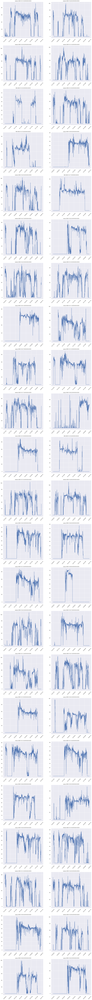

In [100]:
display_data(dfs_1m, 'heart_rate', True, 'all_cleaned_samples_heart_rate_1min.png')

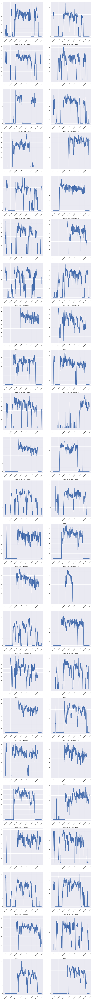

In [101]:
display_data(dfs_1m, 'respiration_rate', True, 'all_cleaned_samples_respiration_rate_1min.png')

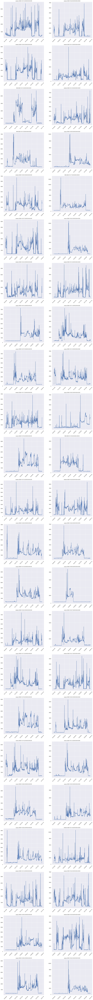

In [106]:
display_data(dfs_1m, 'mss', True, 'all_cleaned_samples_mss_1min.png')

In [102]:
patient_counter = {'ddddd': 0,
                   'eeeee': 0,
                   'ttttt': 0,
                   'vvvvv': 0,
                   'xxxxx': 0,
                   'yyyyy': 0}

for _df in dfs_1m:
    patient = _df.iloc[0].patient
    #print(patient)
    patient_counter[patient] += 1
    nbr = patient_counter[patient]
    
    _df.to_csv(PATH_CLEAN + 'one_min/' + f'{patient}_{nbr}.csv')

print(patient_counter)

{'ddddd': 0, 'eeeee': 18, 'ttttt': 4, 'vvvvv': 0, 'xxxxx': 8, 'yyyyy': 16}
